In [7]:
import os
import glob
import pandas as pd
import numpy as np
import scipy.stats as stats
from sklearn.metrics import r2_score
import matplotlib.pyplot as plt
from sklearn.neighbors import KernelDensity

In [8]:
def load_average_scores():
    rsivl = "/ptmp/tshen/shared/RSIVL/labels.xls"
    visc = "/ptmp/tshen/shared/VISC/VISC-C/labels.csv"

    labels = {}
    labels['rsivl'] = pd.read_excel(rsivl)
    labels['rsivl'].rename(columns={'subjective scores': 'complexity', 'Unnamed: 0': 'filename'}, inplace=True)
    labels['rsivl']['filename'] = labels['rsivl']['filename'] + ".bmp"
    labels['visc'] = pd.read_csv(visc)
    labels['visc'].rename(columns={'score': 'complexity', 'image': 'filename'}, inplace=True)

    for k in labels.keys():
        assert labels[k][['filename', 'complexity']].isnull().values.any() == False

    return labels

In [9]:
def load_predictions(folder="../out/2023July20", filenames=['4points', '8points', '16points', '32points', '64points']):
    rsivl = "{}/RSIVL".format(folder)
    visc = "{}/VISC".format(folder)

    preds = {}
    
    for v, n in zip([rsivl, visc], ["rsivl", "visc"]):
        preds_dataset = []
        single_file_len = 0

        for f in filenames:
            df = pd.read_csv("{}/{}.csv".format(v, f), names=["filename", f], header=None)
            preds_dataset.append(df)
            single_file_len = len(df)

        combined_df = pd.concat([df.set_index("filename") for df in preds_dataset], axis=1, join='inner').reset_index()  # join on filename
        assert len(combined_df) == single_file_len
        assert combined_df.isnull().values.any() == False

        preds[n] = combined_df

    preds['rsivl']['filename'] = preds['rsivl']['filename'].str.replace('.json', '.bmp', regex=False)
    for k in ["visc"]:
        preds[k]['filename'] = preds[k]['filename'].str.replace('.json', '.jpg', regex=False)

    return preds

In [10]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt


def load_subject_scores():
    visc = "./participant_files/"

    files = glob.glob(visc + "*.csv")

    labels = []
    for f in files:
        df = pd.read_csv(f)
        base = os.path.basename(f)
        df = df.rename(columns={"score": "participant{}".format(os.path.splitext(base)[0])})        
        labels.append(df)

    df = pd.concat([df.set_index('image') for df in labels], axis=1, join='outer')

    return labels, df

In [11]:
def load_subject_scores():
    rsivl = "/ptmp/tshen/shared/subject_level_data/rsivl_labels.csv"
    visc = "/ptmp/tshen/shared/subject_level_data/visc_labels.csv"
    visc_participant_ratings = "/ptmp/tshen/shared/subject_level_data/visc_participant_files/"

    labels = {}
    labels['rsivl'] = pd.read_csv(rsivl)
    labels['visc'] = pd.read_csv(visc)

    files = glob.glob(visc_participant_ratings + "*.csv")

    participant_ratings_list = []
    for f in files:
        df = pd.read_csv(f)
        base = os.path.basename(f)
        df = df.rename(columns={"image":"filename", "score": "participant{}".format(os.path.splitext(base)[0])})        
        participant_ratings_list.append(df)

    participant_df = pd.concat([df.set_index('filename') for df in participant_ratings_list], axis=1, join='outer')
    labels['visc'] = pd.concat([labels['visc'].set_index('filename'), participant_df], axis=1, join='outer')
    labels['visc']['filename'] = labels['visc'].index

    return labels

In [12]:
def join_preds_labels(preds, avg_labels, subject_labels):
    data = {}
    
    for k in ["rsivl", "visc"]:
        data[k] = pd.concat(
            [df.set_index("filename") for df in [preds[k], avg_labels[k][['filename', 'complexity']], subject_labels[k]]], 
            axis=1, join='inner').reset_index()

        if k == 'rsivl':
            data[k]['computed_average'] = data[k][['participant{}'.format(i) for i in range(1, 27)]].mean(axis=1)

        elif k == 'visc':
            data[k]['computed_average'] = data[k][['rating{}'.format(i) for i in range(1, 11)]].mean(axis=1)

        if k != 'ic9600':
            assert len(data[k]) == len(preds[k]) == len(avg_labels[k]) == len(subject_labels[k])
        else:
            pass

    assert data['rsivl'].isnull().values.any() == False
    for i in range(1, 41):
        assert data['visc']['participant{}'.format(i)].isna().sum() == (800-200)

    return data

In [13]:
levels = ['4points', '8points', '16points', '32points', '64points']

In [14]:
preds = load_predictions(folder="../out/2023July20", filenames=levels)
avg_labels = load_average_scores()
subject_labels = load_subject_scores()
data = join_preds_labels(preds, avg_labels, subject_labels)

# Remove invalid rows

In [15]:
data['rsivl'] = data['rsivl'][data['rsivl'].participant1 != -9999]

In [16]:
assert len(data['rsivl']) == 48
assert (data['rsivl'] == -9999).sum(axis=0).sum() == 0

# Failure Modes

In [18]:
def sqrt_xform(c):
    return np.sqrt(c)

In [27]:
def get_correlations(x, y):
    model = np.poly1d(np.polyfit(x, y, 1))                
    return stats.pearsonr(x, y), stats.spearmanr(x, y), r2_score(y, model(x))

In [19]:
participants = list(range(1, 41))
participants = [x for x in participants if x not in [7, 14, 28]]

In [25]:
data['visc']['filename']

0      sun_ahhomtyduaznebgb.jpg
1      sun_axcbspaxpiuudsrj.jpg
2      sun_basxvntdnejtfrax.jpg
3      sun_adpzebscgacjxyen.jpg
4      sun_avelkfeereflolze.jpg
                 ...           
795    sun_bjoripfafgpwaito.jpg
796    sun_bjxtkjavbhuarzsl.jpg
797    sun_bsqarutvxoslvqws.jpg
798    sun_aatrbduljuukjgin.jpg
799    sun_bfrshcqxwctwtokz.jpg
Name: filename, Length: 800, dtype: object

0.5675335642259693 0.579237654131026 0.3220943465230325


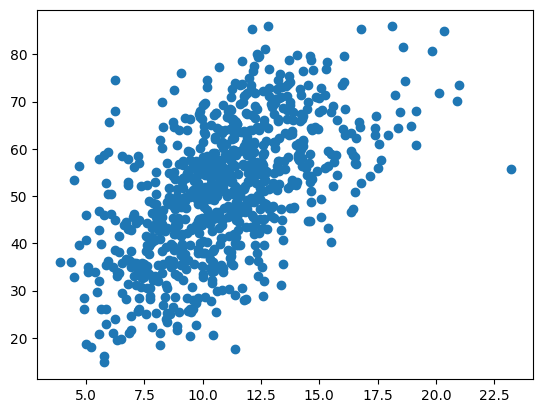

In [32]:
x = sqrt_xform(data['visc']["64points"])
y = data['visc'][["participant{}".format(i) for i in participants]].mean(axis=1)
plt.scatter(x, y)
result = get_correlations(x, y)
pearson, spearman, r2 = result[0].statistic, result[1].statistic, result[2]
print(pearson, spearman, r2)

In [35]:
data['rsivl'].columns

Index(['filename', '4points', '8points', '16points', '32points', '64points',
       'complexity', 'participant1', 'participant2', 'participant3',
       'participant4', 'participant5', 'participant6', 'participant7',
       'participant8', 'participant9', 'participant10', 'participant11',
       'participant12', 'participant13', 'participant14', 'participant15',
       'participant16', 'participant17', 'participant18', 'participant19',
       'participant20', 'participant21', 'participant22', 'participant23',
       'participant24', 'participant25', 'participant26', 'computed_average'],
      dtype='object')

,filename,4points,8points,16points,32points,64points,complexity,computed_average,pred,diff
0,sun_ahhomtyduaznebgb.jpg,8,26,69,183,268,62.10,62.1,66.083210,-3.983210
1,sun_axcbspaxpiuudsrj.jpg,11,29,76,129,152,67.30,67.3,55.039196,12.260804
2,sun_basxvntdnejtfrax.jpg,8,13,37,60,87,62.00,62.0,46.838046,15.161954
3,sun_adpzebscgacjxyen.jpg,7,22,72,132,191,50.67,53.4,59.114422,-8.444422
4,sun_avelkfeereflolze.jpg,11,43,84,136,176,69.80,69.8,57.601286,12.198714
...,...,...,...,...,...,...,...,...,...,...
795,sun_bjoripfafgpwaito.jpg,16,33,73,111,135,73.50,73.5,53.099528,20.400472
796,sun_bjxtkjavbhuarzsl.jpg,14,23,48,73,111,55.40,55.4,50.139532,5.260468
797,sun_bsqarutvxoslvqws.jpg,9,23,73,145,186,54.75,53.7,58.616870,-3.866870
798,sun_aatrbduljuukjgin.jpg,13,41,105,236,367,61.50,60.9,73.697140,-12.197140


In [70]:
outliers = {}

f = np.poly1d(np.polyfit(x, y, 1))
df = data['visc'][['filename', '4points', '8points', '16points', '32points', '64points', 'complexity', 'computed_average']]
df['complexity_no_outliers'] = y
df['pred'] = f(x)
df['diff'] = df['complexity_no_outliers'] - df['pred']

outliers['overestimated'] = df.sort_values(['diff'], ascending=True)
outliers['underestimated'] = df.sort_values(['diff'], ascending=False)
outliers['accurate'] = df.sort_values(by=['diff'], key=abs, ascending=True)

/tmp/ipykernel_119976/157786319.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['complexity_no_outliers'] = y
/tmp/ipykernel_119976/157786319.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['pred'] = f(x)
/tmp/ipykernel_119976/157786319.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.htm

In [71]:
outliers['overestimated'][:10]

,filename,4points,8points,16points,32points,64points,complexity,computed_average,complexity_no_outliers,pred,diff
403,sun_bljymfxujgbxjuvx.jpg,3,11,20,77,130,17.6,17.6,17.600000,52.506063,-34.906063
471,sun_aizcycyyvgfcdnzp.jpg,12,31,61,81,109,21.4,21.4,20.555556,49.879006,-29.323450
465,sun_bgshkoltnrmilxns.jpg,10,14,65,257,539,55.8,55.8,55.800000,84.788293,-28.988293
142,sun_agbvcebowhqfaqoz.jpg,8,21,52,115,158,31.6,31.6,28.777778,55.697641,-26.919864
269,sun_baztjayuqhvdcxph.jpg,17,24,47,68,89,19.6,19.6,20.333333,47.129325,-26.795992
792,sun_ahphmnxxnwuclnfb.jpg,8,20,54,110,178,30.3,30.3,31.222222,57.806667,-26.584444
562,sun_agysnixnkhpsvtmr.jpg,16,31,65,109,141,30.4,30.4,28.222222,53.797360,-25.575138
168,sun_bpizyuxgnkkgbhoc.jpg,6,6,28,69,139,38.8,32.0,28.000000,53.566429,-25.566429
50,sun_brstqndatwxkukya.jpg,4,11,17,47,67,27.7,24.2,18.555556,43.717577,-25.162021
678,sun_ahpwonrlyygmzvtx.jpg,6,34,50,76,94,22.2,22.2,22.777778,47.843515,-25.065738


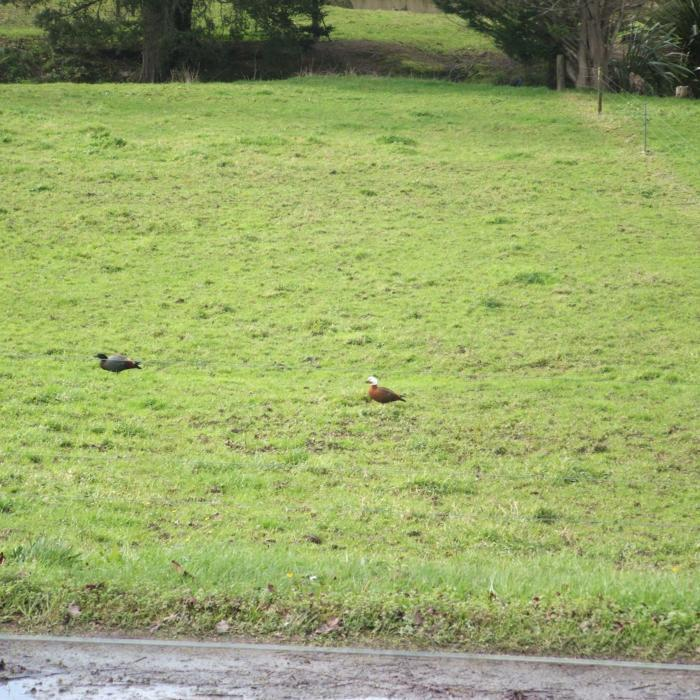

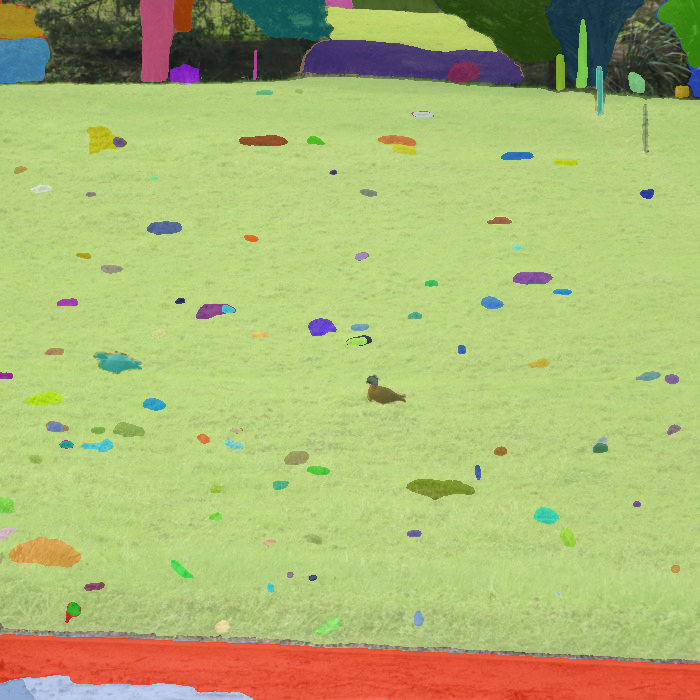

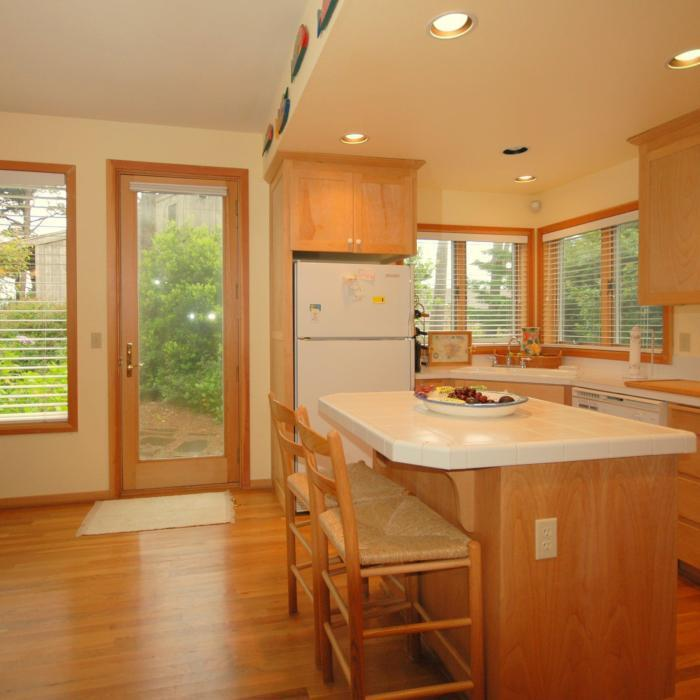

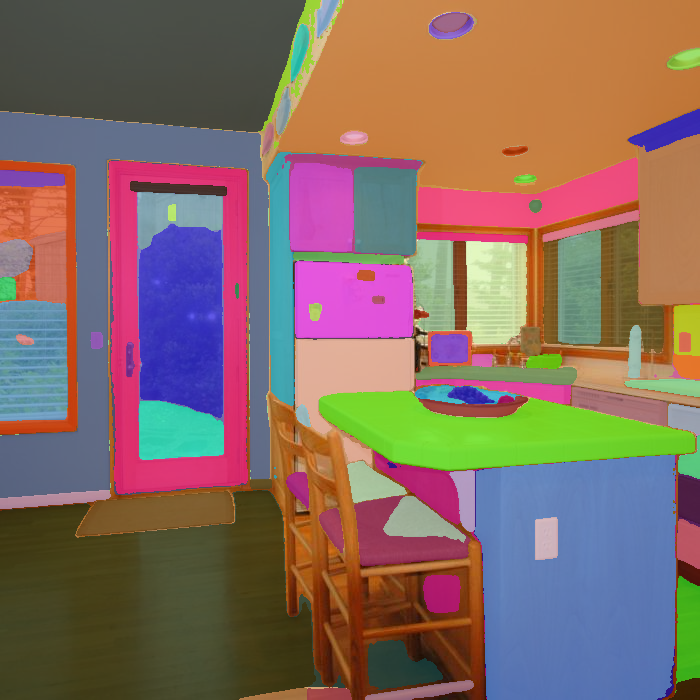

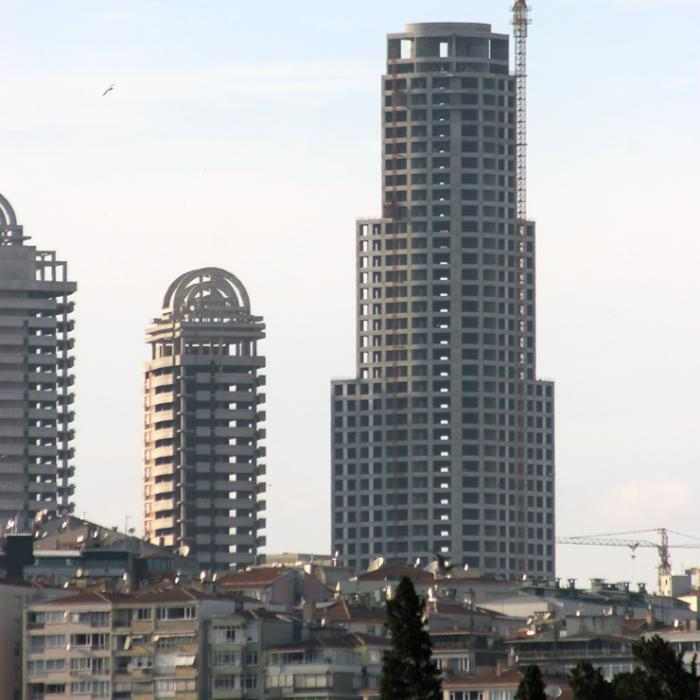

...

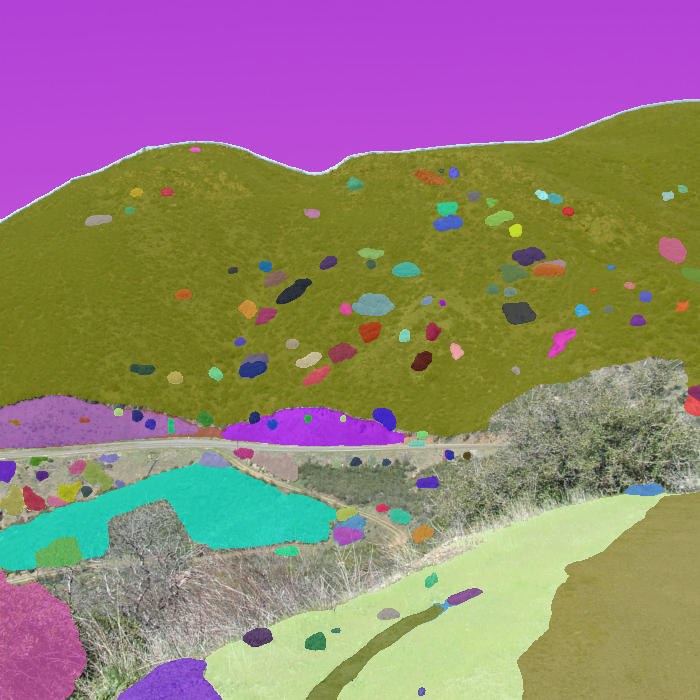

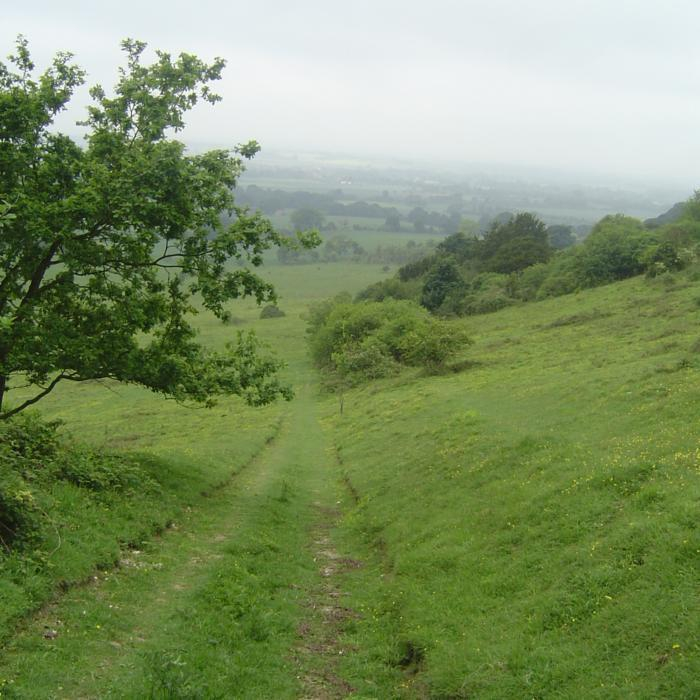

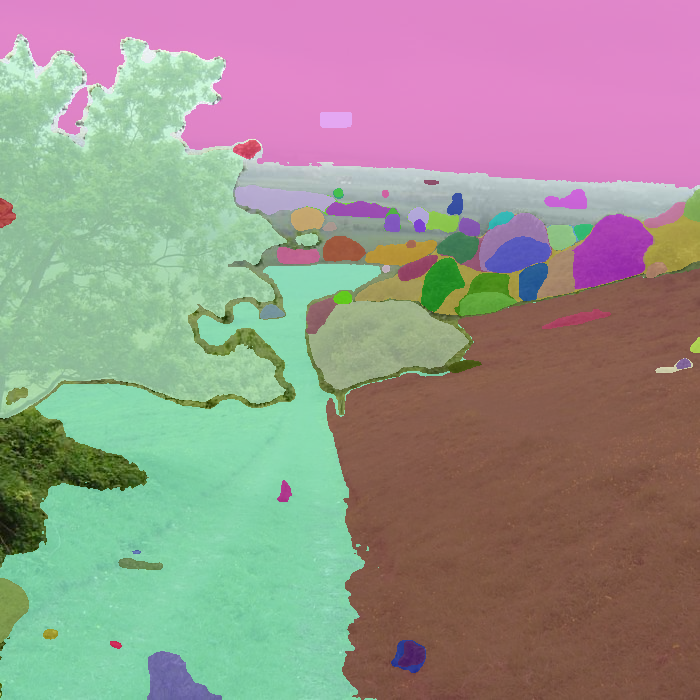

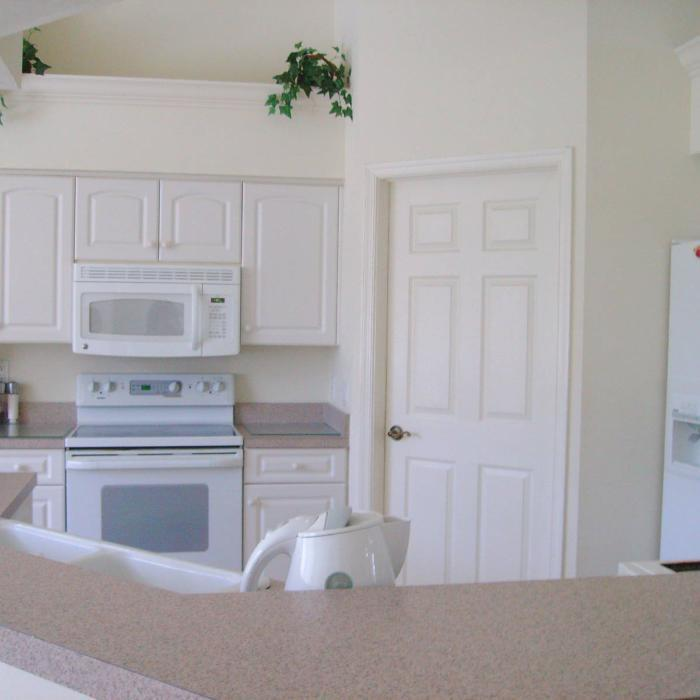

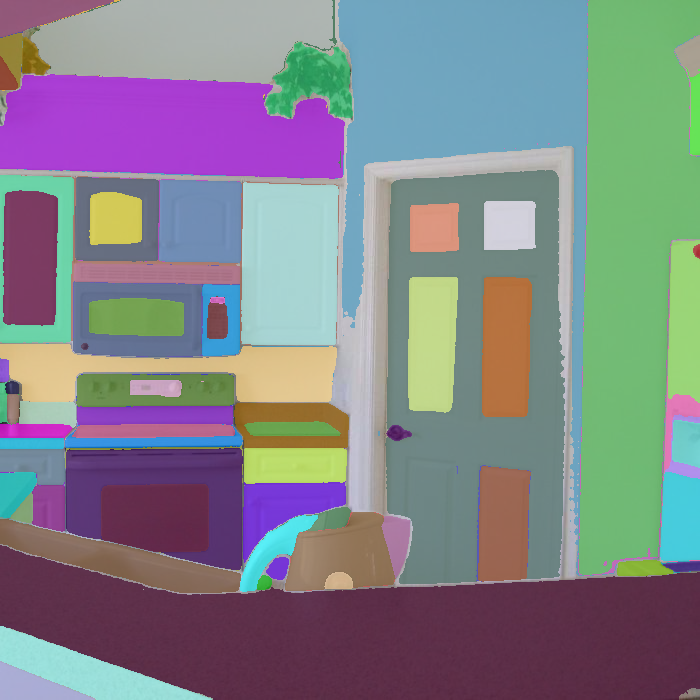

In [72]:
from IPython.display import Image
for i in range(10):
    fname = outliers['overestimated'].iloc[i]['filename']
    image1 = Image(filename="/ptmp/tshen/shared/VISC/VISC-C/images/" + fname, width=300)
    image2 = Image(filename="/ptmp/tshen/shared/Results/2023July20/VISC/64points/" + fname[:-4] + ".png", width=300)
    display(image1, image2)

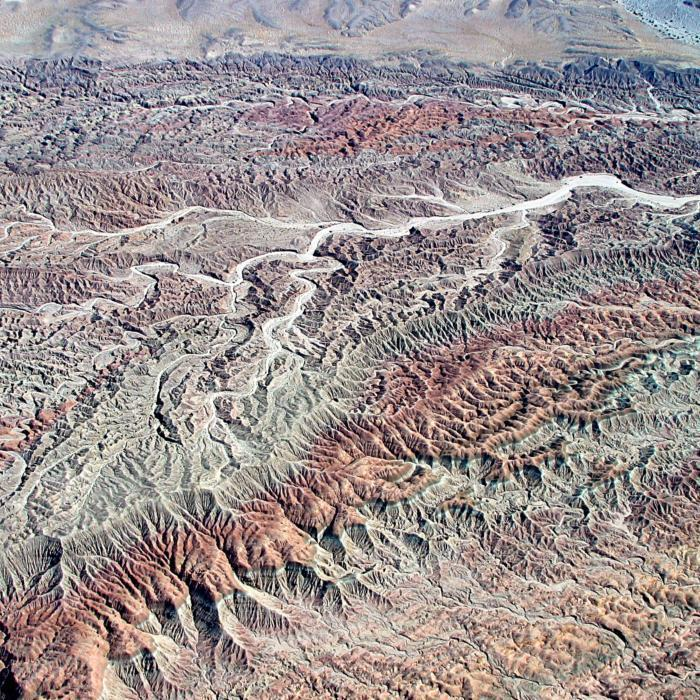

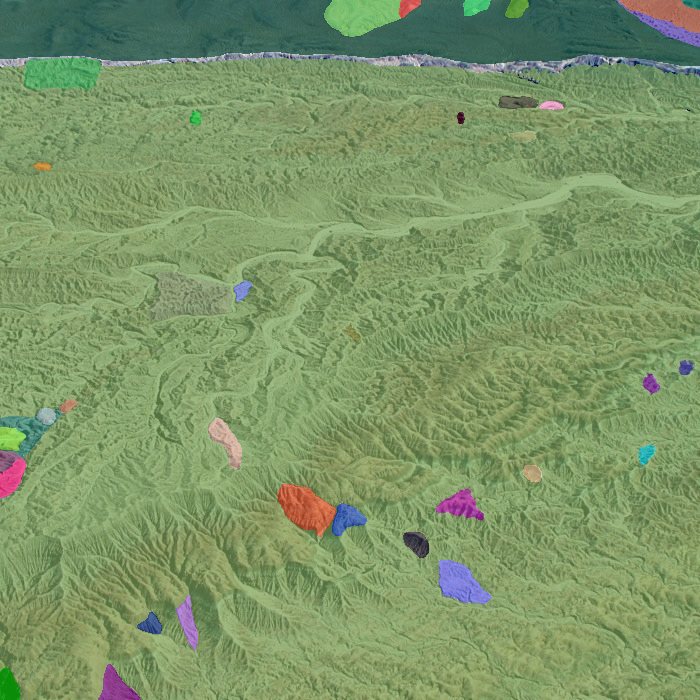

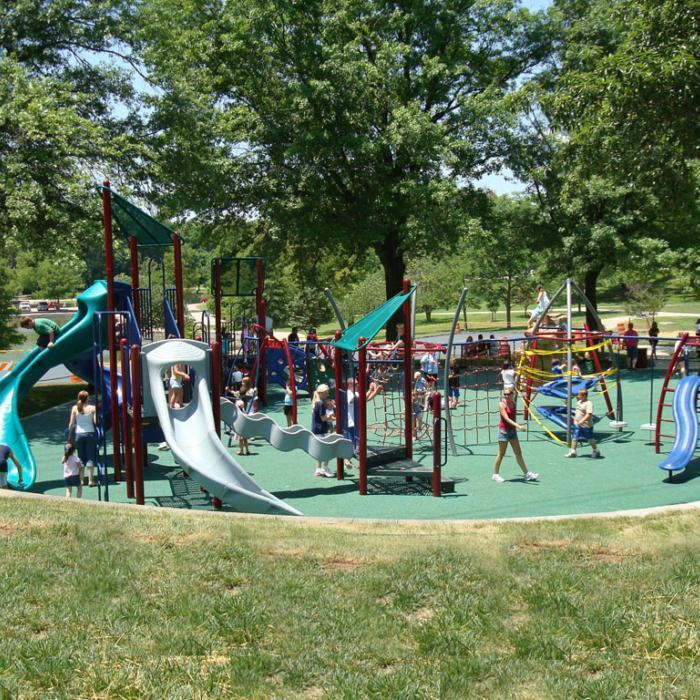

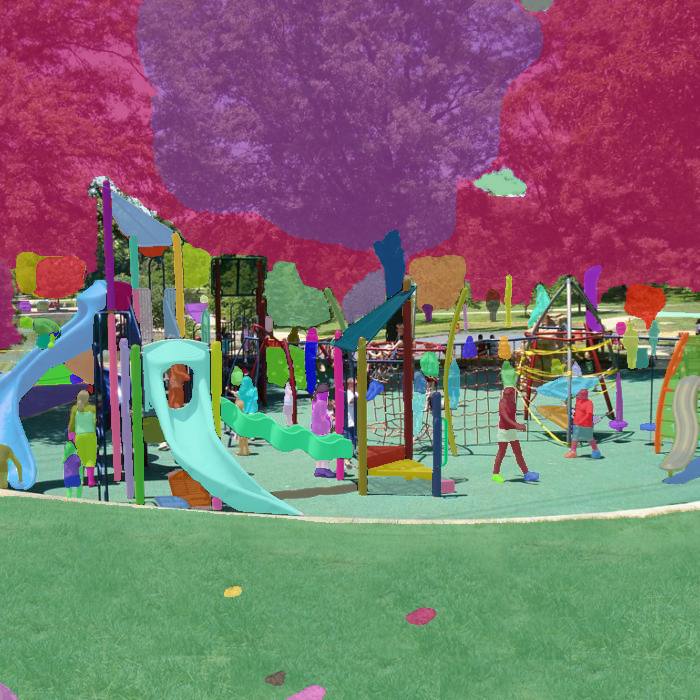

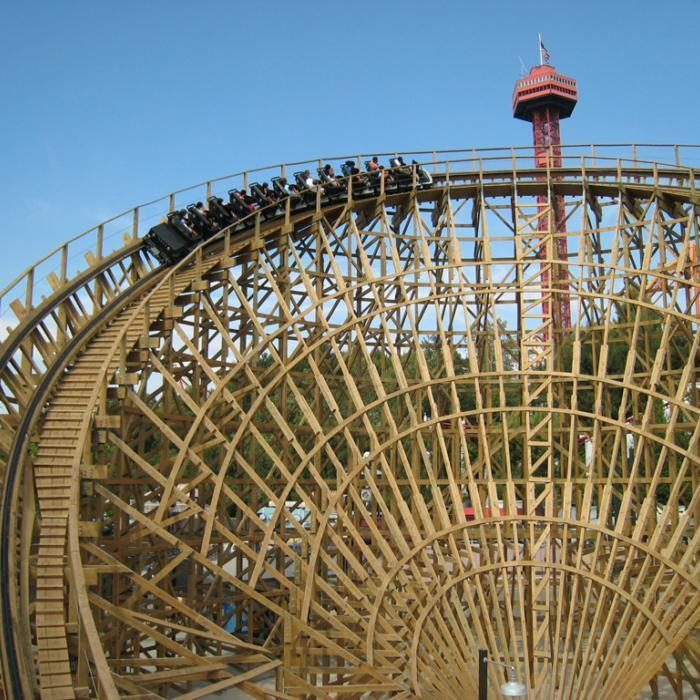

...

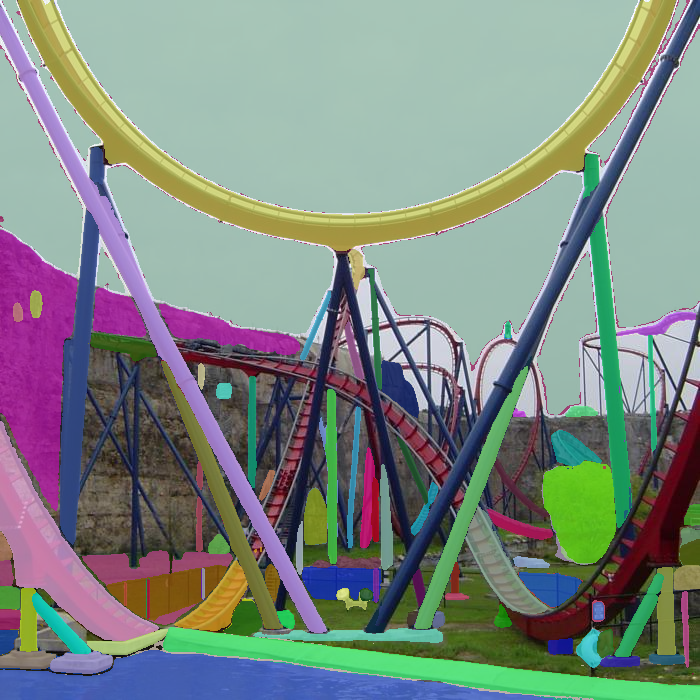

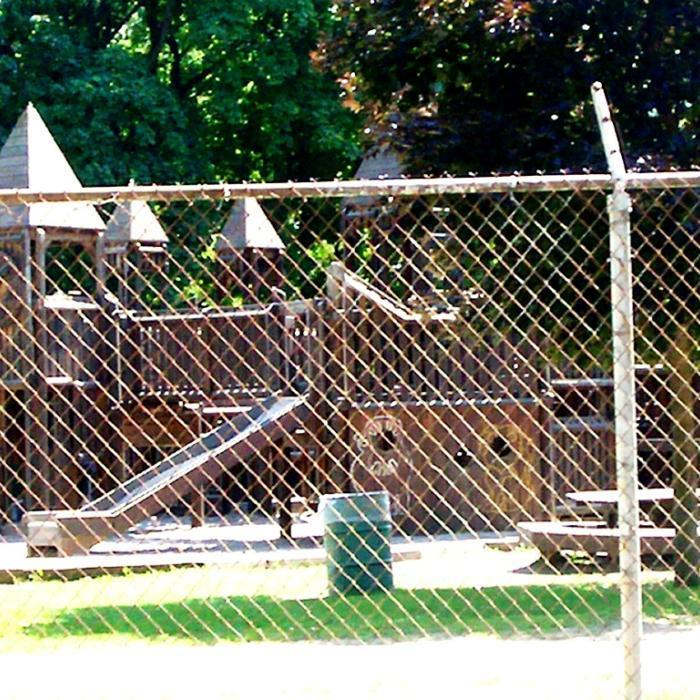

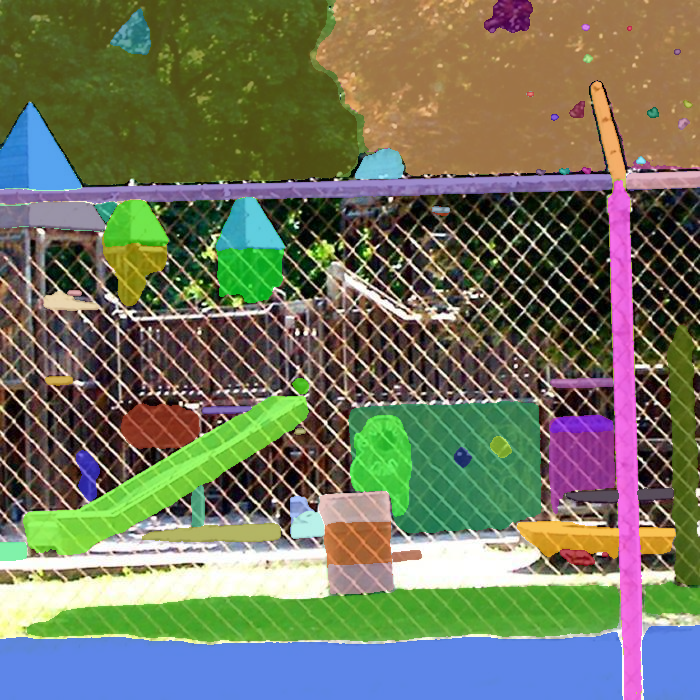

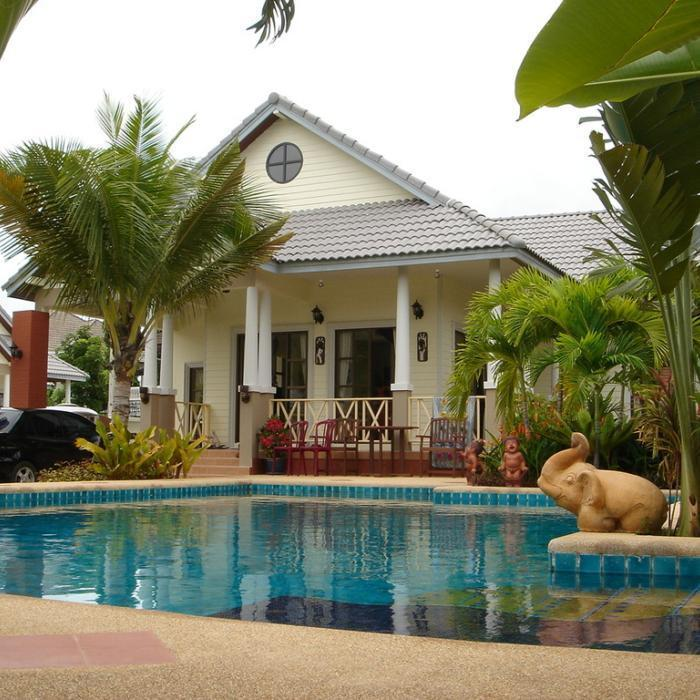

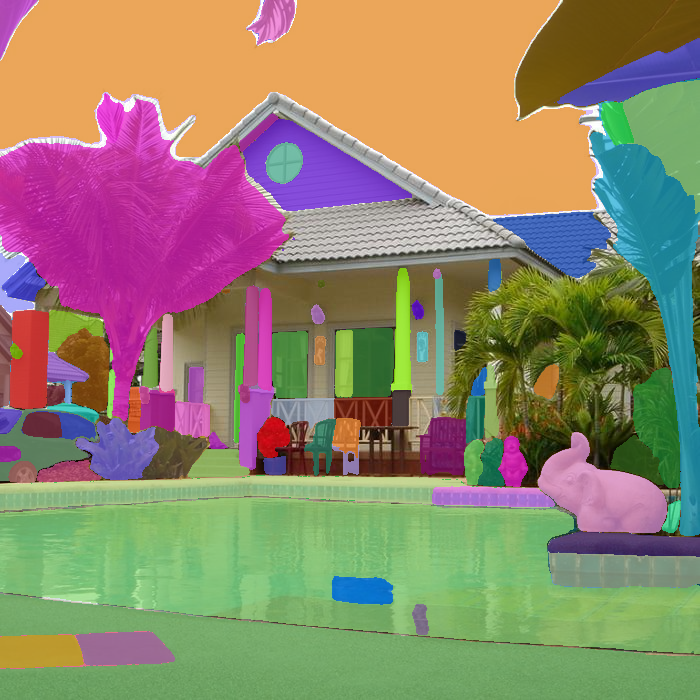

In [68]:
from IPython.display import Image
for i in range(10):
    fname = outliers['underestimated'].iloc[i]['filename']
    image1 = Image(filename="/ptmp/tshen/shared/VISC/VISC-C/images/" + fname, width=300)
    image2 = Image(filename="/ptmp/tshen/shared/Results/2023July20/VISC/64points/" + fname[:-4] + ".png", width=300)
    display(image1, image2)

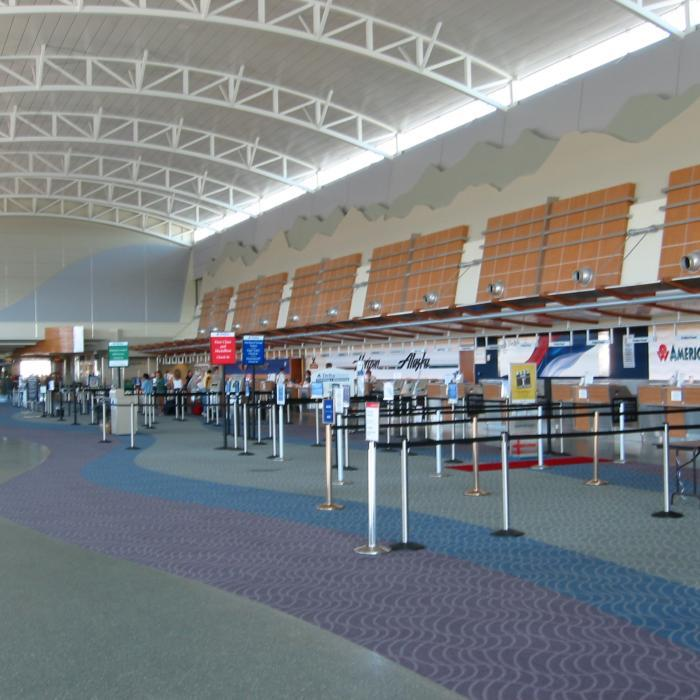

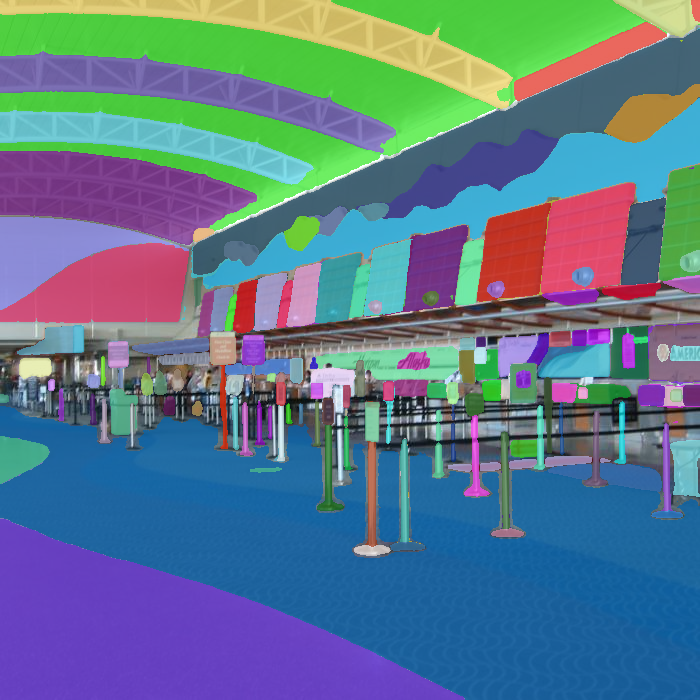

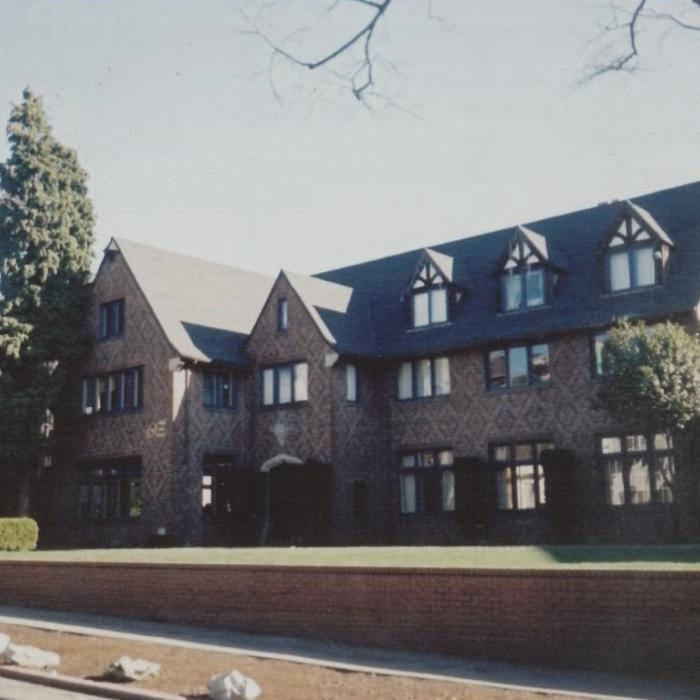

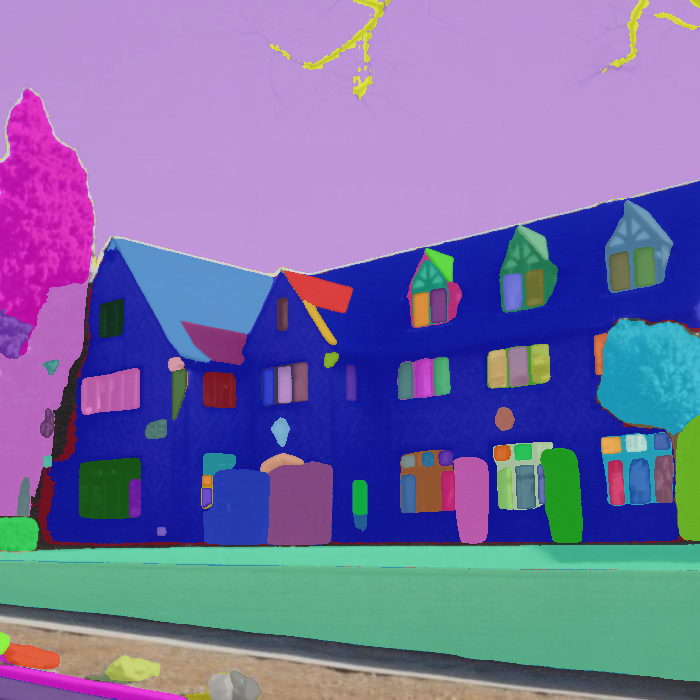

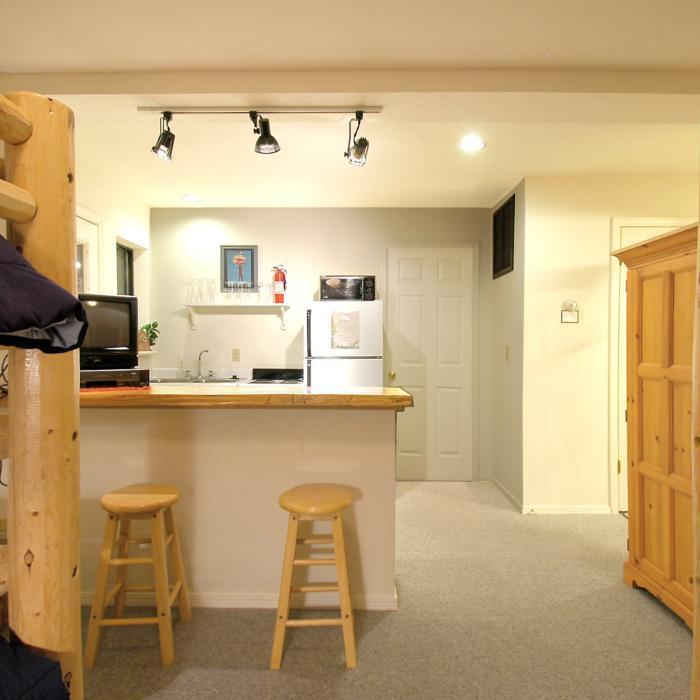

...

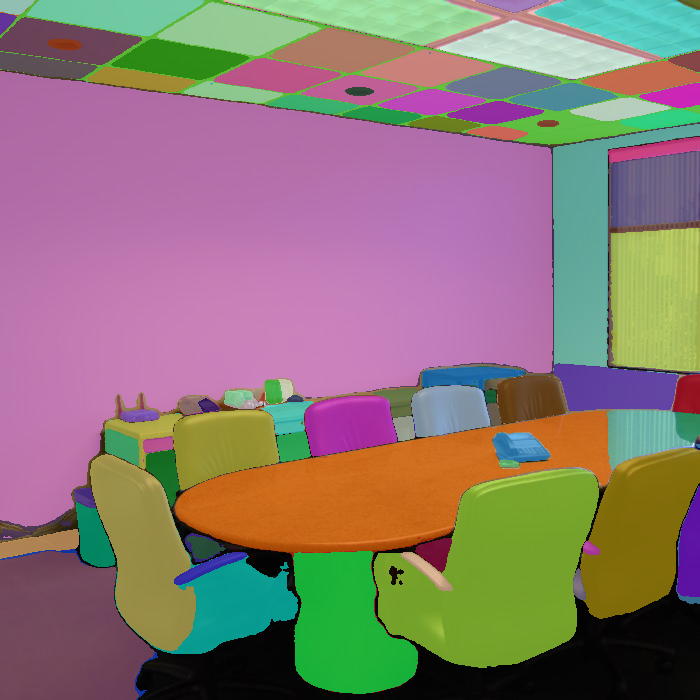

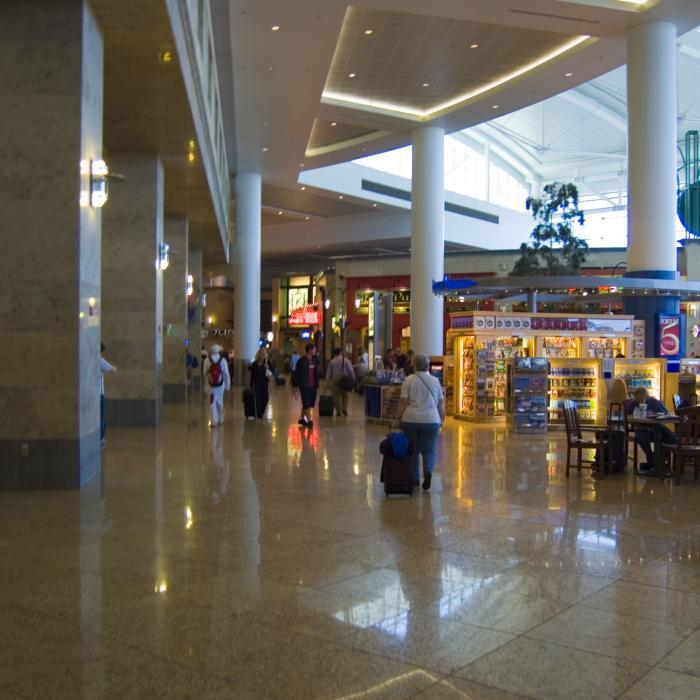

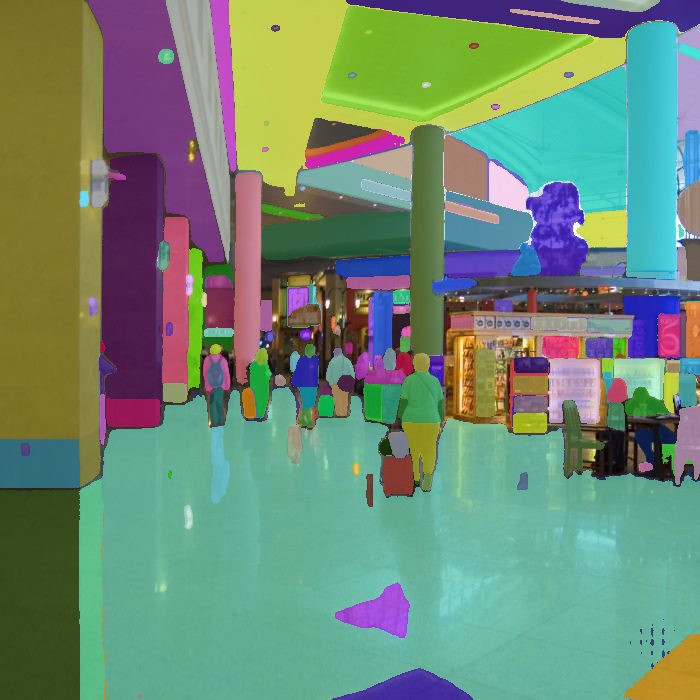

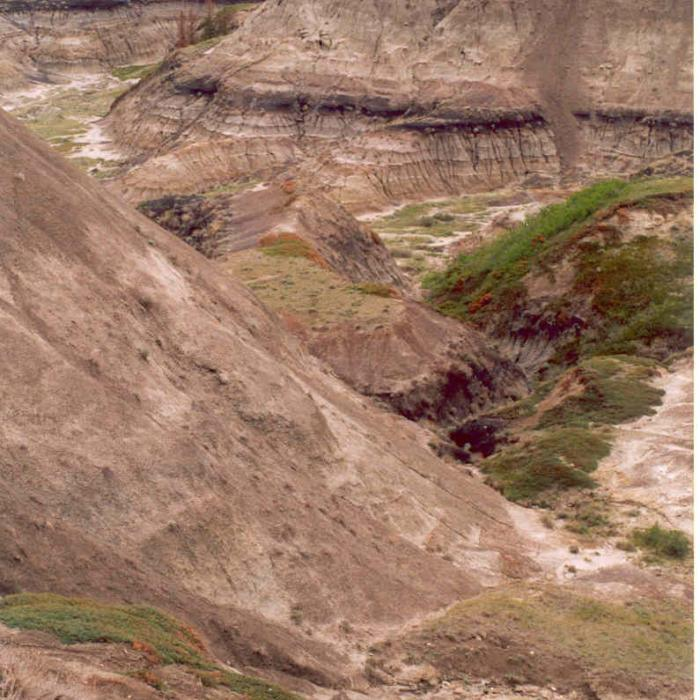

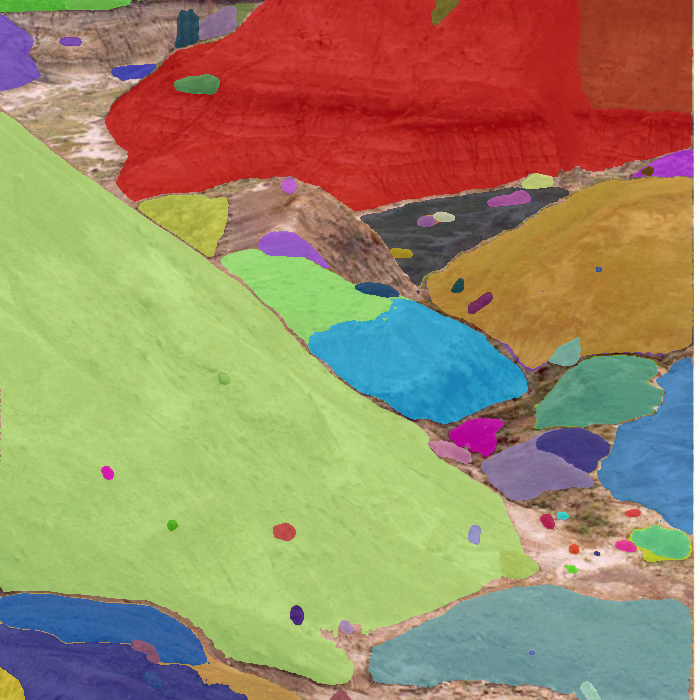

In [69]:
from IPython.display import Image
for i in range(10):
    fname = outliers['accurate'].iloc[i]['filename']
    image1 = Image(filename="/ptmp/tshen/shared/VISC/VISC-C/images/" + fname, width=300)
    image2 = Image(filename="/ptmp/tshen/shared/Results/2023July20/VISC/64points/" + fname[:-4] + ".png", width=300)
    display(image1, image2)